In [1]:
using CSV, Plots, ProgressMeter

In [2]:
function normalize(x)
    (x .- minimum(x))./(maximum(x) - minimum(x))
end

function normalize(x::AbstractArray{Union{Missing, T}}) where {T<:Number}
    x_fix = replace(x,(Missing()=>0.0))
    (x_fix .- minimum(x_fix))./(maximum(x_fix) - minimum(x_fix))
end

normalize (generic function with 2 methods)

In [5]:
f = CSV.File("../raw_data/occupancy_data/datatest.txt");

In [6]:
sum(f.Occupancy)/length(f)

0.23103112840466927

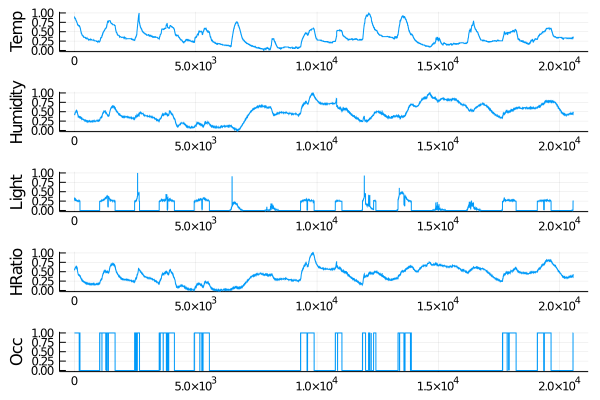

In [7]:
plot(
    plot(normalize(f.Temperature), ylabel="Temp", legend=nothing),
    plot(normalize(f.Humidity), ylabel="Humidity", legend=nothing),
    plot(normalize(f.Light), ylabel="Light", legend=nothing),
    plot(normalize(f.HumidityRatio), ylabel="HRatio", legend=nothing),
    plot(normalize(f.Occupancy), ylabel="Occ", legend=nothing),
    layout = (5, 1)
)

In [17]:
function animate_timeseries(timeseries_loc, save_loc, plot_properties; kwargs...)
    f = CSV.File(timeseries_loc; kwargs...);
    np = length(plot_properties)
    frames=1:1000:(length(getproperty(f, Symbol(plot_properties[1])))-11000)
    p = Progress(length(frames), "Animation")
    anim = @animate for frame in frames
        next!(p)
        plot([plot(normalize(getproperty(f, Symbol(prop)))[(0:10000) .+ frame], label=nothing, ylabel=prop, ylims=(0,1)) for prop in plot_properties]..., layout=(np, 1), size=(600, 1600))
    end
    mp4(anim, save_loc, fps=15)
end

animate_timeseries (generic function with 1 method)

In [9]:
animate_timeseries("../raw_data/buzz/Twitter/Twitter.data", "buzz.mp4", ["Column$(i)" for i in 1:7:78]; header=false)

Animation100%|██████████████████████████████████████████| Time: 0:03:11
┌ Info: Saved animation to 
│   fn = /Users/Matt/Documents/Research/projects/GVFN/jupyter/buzz.mp4
└ @ Plots /Users/Matt/.julia/packages/Plots/ninUP/src/animation.jl:104


Plots.AnimatedGif("/Users/Matt/Documents/Research/projects/GVFN/jupyter/buzz.mp4")

In [50]:
ts_loc = "../raw_data/PRSA_Data_20130301-20170228/PRSA_Data_Aotizhongxin_20130301-20170228.csv"
# f = CSV.File(ts_loc, missingstring="NA");
animate_timeseries(ts_loc, "Aotizhongxin.mp4", ["PM2.5", "PM10", "SO2", "NO2", "CO", "O3", "TEMP", "PRES", "DEWP", "RAIN", "WSPM"]; missingstring="NA")

35064-element CSV.File{false}:
 CSV.Row: (No = 1, year = 2013, month = 3, day = 1, hour = 0, PM2.5 = 4.0, PM10 = 4.0, SO2 = 4.0, NO2 = 7.0, CO = 300, O3 = 77.0, TEMP = -0.7, PRES = 1023.0, DEWP = -18.8, RAIN = 0.0, wd = "NNW", WSPM = 4.4, station = "Aotizhongxin")
 CSV.Row: (No = 2, year = 2013, month = 3, day = 1, hour = 1, PM2.5 = 8.0, PM10 = 8.0, SO2 = 4.0, NO2 = 7.0, CO = 300, O3 = 77.0, TEMP = -1.1, PRES = 1023.2, DEWP = -18.2, RAIN = 0.0, wd = "N", WSPM = 4.7, station = "Aotizhongxin")
 CSV.Row: (No = 3, year = 2013, month = 3, day = 1, hour = 2, PM2.5 = 7.0, PM10 = 7.0, SO2 = 5.0, NO2 = 10.0, CO = 300, O3 = 73.0, TEMP = -1.1, PRES = 1023.5, DEWP = -18.2, RAIN = 0.0, wd = "NNW", WSPM = 5.6, station = "Aotizhongxin")
 CSV.Row: (No = 4, year = 2013, month = 3, day = 1, hour = 3, PM2.5 = 6.0, PM10 = 6.0, SO2 = 11.0, NO2 = 11.0, CO = 300, O3 = 72.0, TEMP = -1.4, PRES = 1024.5, DEWP = -19.4, RAIN = 0.0, wd = "NW", WSPM = 3.1, station = "Aotizhongxin")
 CSV.Row: (No = 5, year = 2013, m

In [19]:
ts_loc = "../raw_data/gas_mistures_2015/ethylene_methane.txt"
# CSV.File(ts_loc, skipto=2, header=false, limit=100, delim=" ", ignorerepeated=true)[1]
animate_timeseries(ts_loc, "mixtures_ethylene_me.mp4", ["Column$(i)" for i in 2:(3+16)];skipto=2, header=false, delim=" ", ignorerepeated=true, limit=1000000)

Animation100%|██████████████████████████████████████████| Time: 0:10:31
┌ Info: Saved animation to 
│   fn = /Users/Matt/Documents/Research/projects/GVFN/jupyter/mixtures_ethylene_me.mp4
└ @ Plots /Users/Matt/.julia/packages/Plots/ninUP/src/animation.jl:104


Plots.AnimatedGif("/Users/Matt/Documents/Research/projects/GVFN/jupyter/mixtures_ethylene_me.mp4")

UndefVarError: UndefVarError: SentinelArrays not defined